# How important are foreign players in current NBA?
There is no doubt that foreign players are important in the NBA, as in the last seasons we have seen a foreign player winning the MVP two years in a row, Giannis Antetokounmpo. Or dominant and important players like Luka Dončić or Nikola Jokić for their respective teams in the playoffs. 

But how many foreign are today in the NBA? Or what proportion do they represent in the total proportion of players?. In this project, we are going to find out these questions and also get a better picture of the NBA foreign players, in terms of how the numbers have change through time, in which positions they play and which teams have more foreign players. 

To do this analysis, we are going to use two datasets:
* NBA players dataset from Kaggle, containing information on biometrics and biography of players from 1996-2019 season. The dataset can be download from [here](https://www.kaggle.com/justinas/nba-players-data).
* NBA positions in 2019-2020 season from Basketball Reference, this to have the information of the respective position of each player. The dataset can be download from [here](https://www.basketball-reference.com/leagues/NBA_2020_totals.html).




## Data import
First, we are going to import the two datasets and have a quick look of them.

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import json
import plotly
plotly.offline.init_notebook_mode()



In [2]:
nba_players = pd.read_csv('all_seasons.csv')
nba_players.head()

,Unnamed: 0,player_name,team_abbreviation,age,player_height,player_weight,college,country,draft_year,draft_round,...,pts,reb,ast,net_rating,oreb_pct,dreb_pct,usg_pct,ts_pct,ast_pct,season
0,0,Dennis Rodman,CHI,36.0,198.12,99.790240,Southeastern Oklahoma State,USA,1986,2,...,5.7,16.1,3.1,16.1,0.186,0.323,0.100,0.479,0.113,1996-97
1,1,Dwayne Schintzius,LAC,28.0,215.90,117.933920,Florida,USA,1990,1,...,2.3,1.5,0.3,12.3,0.078,0.151,0.175,0.430,0.048,1996-97
2,2,Earl Cureton,TOR,39.0,205.74,95.254320,Detroit Mercy,USA,1979,3,...,0.8,1.0,0.4,-2.1,0.105,0.102,0.103,0.376,0.148,1996-97
3,3,Ed O'Bannon,DAL,24.0,203.20,100.697424,UCLA,USA,1995,1,...,3.7,2.3,0.6,-8.7,0.060,0.149,0.167,0.399,0.077,1996-97
4,4,Ed Pinckney,MIA,34.0,205.74,108.862080,Villanova,USA,1985,1,...,2.4,2.4,0.2,-11.2,0.109,0.179,0.127,0.611,0.040,1996-97


In [3]:
nba_players.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11145 entries, 0 to 11144
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         11145 non-null  int64  
 1   player_name        11145 non-null  object 
 2   team_abbreviation  11145 non-null  object 
 3   age                11145 non-null  float64
 4   player_height      11145 non-null  float64
 5   player_weight      11145 non-null  float64
 6   college            11145 non-null  object 
 7   country            11145 non-null  object 
 8   draft_year         11145 non-null  object 
 9   draft_round        11145 non-null  object 
 10  draft_number       11145 non-null  object 
 11  gp                 11145 non-null  int64  
 12  pts                11145 non-null  float64
 13  reb                11145 non-null  float64
 14  ast                11145 non-null  float64
 15  net_rating         11145 non-null  float64
 16  oreb_pct           111

In [4]:
positions = pd.read_csv('positions.csv')
positions.head()

,Rk,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,...,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
0,1,Steven Adams\adamsst01,C,26,OKC,63,63,1680,283,478,...,0.582,207,376,583,146,51,67,94,122,684
1,2,Bam Adebayo\adebaba01,PF,22,MIA,72,72,2417,440,790,...,0.691,176,559,735,368,82,93,204,182,1146
2,3,LaMarcus Aldridge\aldrila01,C,34,SAS,53,53,1754,391,793,...,0.827,103,289,392,129,36,87,74,128,1001
3,4,Kyle Alexander\alexaky01,PF,23,MIA,2,0,13,1,2,...,NaN,2,1,3,0,0,0,1,1,2
4,5,Nickeil Alexander-Walker\alexani01,SG,21,NOP,47,1,591,98,266,...,0.676,9,75,84,89,17,8,54,57,267


In [5]:
positions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 529 entries, 0 to 528
Data columns (total 30 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Rk      529 non-null    int64  
 1   Player  529 non-null    object 
 2   Pos     529 non-null    object 
 3   Age     529 non-null    int64  
 4   Tm      529 non-null    object 
 5   G       529 non-null    int64  
 6   GS      529 non-null    int64  
 7   MP      529 non-null    int64  
 8   FG      529 non-null    int64  
 9   FGA     529 non-null    int64  
 10  FG%     527 non-null    float64
 11  3P      529 non-null    int64  
 12  3PA     529 non-null    int64  
 13  3P%     502 non-null    float64
 14  2P      529 non-null    int64  
 15  2PA     529 non-null    int64  
 16  2P%     526 non-null    float64
 17  eFG%    527 non-null    float64
 18  FT      529 non-null    int64  
 19  FTA     529 non-null    int64  
 20  FT%     504 non-null    float64
 21  ORB     529 non-null    int64  
 22  DR

There aren't any null values in both datasets, but as we can see, the dataframes need some cleaning, like removing unnecessary columns and have an agreement with the names. 

## Data cleaning
We are going to start the cleaning with the nba_players dataframe, first we are going to isolate the columns of interest and generate two more columns. The first column will be a Boolean column if a player is foreign or not and the second one will be a label if a player is foreign or from the USA.

In [6]:
nba_players = nba_players[['player_name','team_abbreviation', 'age', 'country', 'season']]
nba_players['foreign'] = nba_players.apply(lambda x: False if x['country']=='USA' else True, axis=1)
nba_players['foreign_label'] = nba_players.apply(lambda x: 'USA' if x['country'] == 'USA' else 'Foreign', axis=1)
nba_players.tail()

,player_name,team_abbreviation,age,country,season,foreign,foreign_label
11140,Maxi Kleber,DAL,28.0,Germany,2019-20,True,Foreign
11141,Melvin Frazier Jr.,ORL,23.0,USA,2019-20,False,USA
11142,Meyers Leonard,MIA,28.0,USA,2019-20,False,USA
11143,Norvel Pelle,PHI,27.0,USA,2019-20,False,USA
11144,Matt Thomas,TOR,25.0,USA,2019-20,False,USA


From this dataframe, we are going to generate another one just from the last season, 2019 - 2020. This will be the input for the merge with the positions dataframe. Also, we are going to modify the names in this dataset to match the ones in the positions one. 

The problem is related of how the names were written, in the nba_players dataset, the names don't include special characters and in the positions dataset they do. So, we are going to replace the names in the nba_players dataset with the names including special characters. 

Note: The analysis of which names needed to be changed was previously done. 

In [7]:
names={'Goran Dragic':'Goran Dragić', 'Harry Giles III':'Harry Giles', 'Frank Mason':'Frank Mason III',
 'Dzanan Musa':'Džanan Musa','Ersan Ilyasova':'Ersan İlyasova','Jonas Valanciunas':'Jonas Valančiūnas',
 'Boban Marjanovic':'Boban Marjanović','Bogdan Bogdanovic':'Bogdan Bogdanović',
 'Bojan Bogdanovic':'Bojan Bogdanović','Alen Smailagic':'Alen Smailagić','Ante Zizic':'Ante Žižić',
 'Anzejs Pasecniks':'Anžejs Pasečņiks','Davis Bertans':'Dāvis Bertāns','Dennis Schroder':'Dennis Schröder',
 'Dario Saric':'Dario Šarić','Cristiano Felicio':'Cristiano Felício','Skal Labissiere':'Skal Labissière',
 'Svi Mykhailiuk':'Sviatoslav Mykhailiuk','Vlatko Cancar':'Vlatko Čančar','Willy Hernangomez':'Willy Hernangómez',
 'Timothe Luwawu-Cabarrot':'Timothé Luwawu-Cabarrot','Tomas Satoransky':'Tomáš Satoranský',
 'Kristaps Porzingis':'Kristaps Porziņģis','Juancho Hernangomez':'Juan Hernangómez',
 'Luka Doncic':'Luka Dončić','Luka Samanic':'Luka Šamanić','Nicolo Melli':'Nicolò Melli',
 'Nikola Jokic':'Nikola Jokić','Nikola Vucevic':'Nikola Vučević'}

In [8]:
nba_players_2020 = nba_players[nba_players['season'] == '2019-20'].copy()
nba_players_2020.replace(names, inplace=True)

Prior to the merge, we need to correct the player names and give the same format that the nba_players_2020 dataset is. 

In [9]:
positions['Player'] = positions.Player.replace(to_replace=r'\\.+', value='', regex=True)
positions.rename(columns={'Player': 'player_name'}, inplace=True)
positions.drop_duplicates(keep='first',inplace=True)
positions = positions[['player_name','Pos']]
positions.head()

,player_name,Pos
0,Steven Adams,C
1,Bam Adebayo,PF
2,LaMarcus Aldridge,C
3,Kyle Alexander,PF
4,Nickeil Alexander-Walker,SG


The merge will be a left joint of the nba_players_2020 with the positions dataset. 

In [10]:
nba_players_2020 = nba_players_2020.merge(positions, how='left', on='player_name')
nba_players_2020.head()

,player_name,team_abbreviation,age,country,season,foreign,foreign_label,Pos
0,Georges Niang,UTA,26.0,USA,2019-20,False,USA,PF
1,George Hill,MIL,33.0,USA,2019-20,False,USA,PG
2,Gary Trent Jr.,POR,21.0,USA,2019-20,False,USA,SG
3,Gary Payton II,WAS,27.0,USA,2019-20,False,USA,PG
4,Gary Harris,DEN,25.0,USA,2019-20,False,USA,SG


## Data analysis
As we want to know how important foreign players are in the NBA, we are going to analyze the data in terms of four factors:
* How the number of foreign players has changed from 1996 to 2020.
* Which countries export most players that go into the NBA.
* In which positions do the foreign players play?
* How is the number of foreign players being distributed through the teams?




### Foreign players from 1996 season to 2020 season
To get an idea of how the importance of foreign player has changed in time, we are going to obtain the total number of players in each season of the dataset, and also generate a proportion of foreign vs nationals in the 1996 season and in the last season.

After that we are going to plot this information to obtain some insight. 

In [11]:
foreigns_overtime = nba_players.groupby('season').sum()
proportion_players_1996 = nba_players.loc[nba_players['season'] == '1996-97', 'foreign_label'].value_counts()
proportion_players_2020 = nba_players.loc[nba_players['season'] == '2019-20', 'foreign_label'].value_counts()

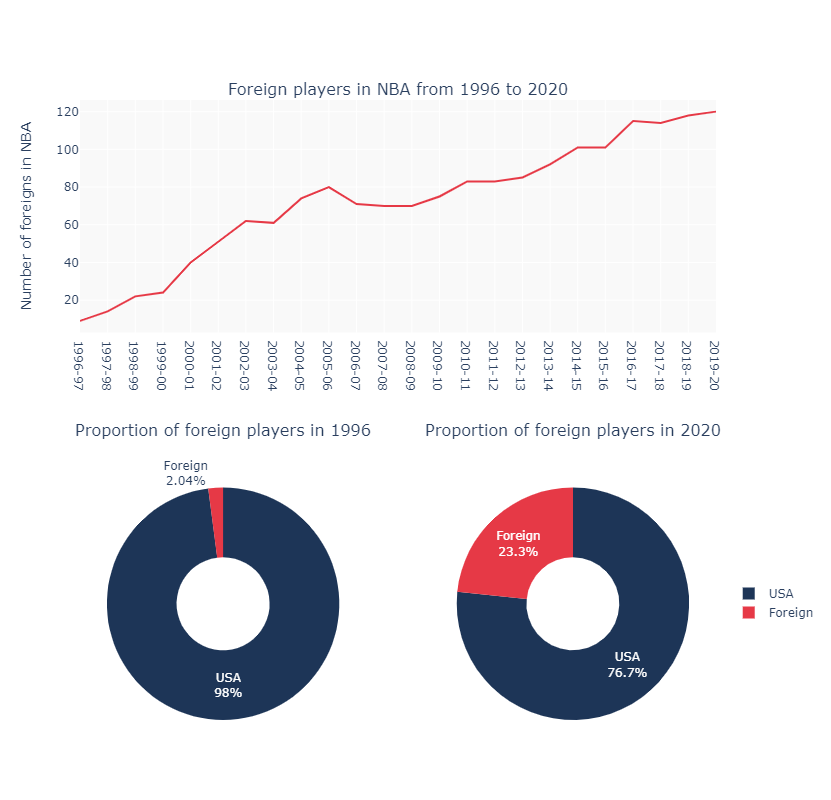

In [12]:
fig = make_subplots(
    rows=2, cols=2,
    specs=[[{"colspan": 2}, None],
           [{"type": "pie"}, {"type": "pie"}]],
    subplot_titles=('Foreign players in NBA from 1996 to 2020',"Proportion of foreign players in 1996", "Proportion of foreign players in 2020"))

fig.add_trace(go.Scatter(x=foreigns_overtime.index, y=foreigns_overtime.foreign, mode='lines',
                    showlegend=False, line={'color':'#e63946'},
                    hovertemplate='<b>Season %{x}</b>' + '<br>Number of foreigns: %{y}<extra></extra>'),
                 row=1, col=1)

fig.update_xaxes(tickangle=90,type='category', row=1, col=1)
fig.update_yaxes(title_text='Number of foreigns in NBA', row=1, col=1)

fig.add_trace(go.Pie(labels=proportion_players_1996.index, values=proportion_players_1996, textinfo='label+percent',
                            marker={'colors':['#1d3557','#e63946']}, hole=.4, name=''), row=2, col=1)

fig.add_trace(go.Pie(labels=proportion_players_2020.index, values=proportion_players_2020, textinfo='label+percent',
                            marker={'colors':['#1d3557','#e63946']}, hole=.4, name=''), row=2, col=2)

fig.update_layout(height=800, width=800, plot_bgcolor="#F9F9F9", legend={'y':.15})
fig.update_annotations(y=.45, selector={'text':'Proportion of foreign players in 1996'})
fig.update_annotations(y=.45, selector={'text':'Proportion of foreign players in 2020'})

plotly.offline.iplot(fig, filename='proportion_foreigns')

As we can see from the graphs above, the number of foreign players has dramatically increased from 1996 to the last season. In 1996-97 season, there were only 9 players, making just 2% percent of the total players in NBA. And in the 2019-20 season, the number has increased to 120, making 23.3% of the league players, almost a quarter of all players. 

Also, by looking at the top graph, we can see that the increase has been constant and it wasn't a sudden increment.  

### Countries of the foreign players in NBA
Now, we are going to find out from which countries the foreign players of 2019-20 season come from. And see if there any trends in this information. 

In order to do this, we are going to generate a choropleth map of the world denoting the number of players per country, excluding the USA. 

In [13]:
players_by_country= nba_players[nba_players.season == '2019-20'].groupby('country').sum()
players_by_country

,age,foreign
country,,
Angola,21.0,1.0
Australia,252.0,9.0
Austria,24.0,1.0
Bahamas,48.0,2.0
Bosnia and Herzegovina,20.0,1.0
Brazil,78.0,3.0
Cameroon,50.0,2.0
Canada,460.0,19.0
Croatia,167.0,7.0


In [14]:
players_by_country.drop('USA', inplace=True)

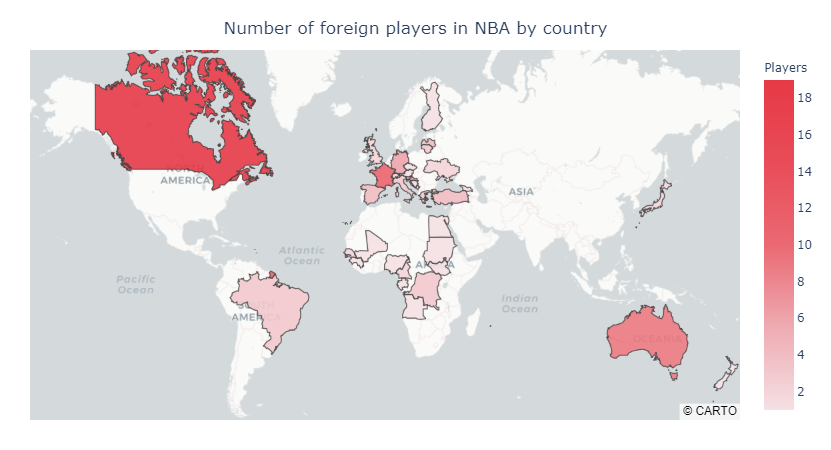

In [15]:
json_file = open('custom_coun.json')
countries = json.load(json_file)

palette = plotly.colors.make_colorscale(["#f5e0e4","#eeabb2","#ea6973","#e84c58","#e63946"]
)
fig = px.choropleth_mapbox(players_by_country, geojson=countries, color="foreign",
                           locations=players_by_country.index, featureidkey="properties.admin",
                           center={"lat": 23, "lon": 3},
                           mapbox_style="carto-positron", zoom=.5, 
                           color_continuous_scale=palette, labels={'foreign':'Players'},
                           opacity=.9,custom_data=[players_by_country.index, 'foreign'],
                           title='Number of foreign players in NBA by country')
fig.update_layout(margin={"b":30,'l':30,'t':50})
fig.update_traces(
    hovertemplate='<b>%{customdata[0]}</b>' +  "<br>Number of players: %{customdata[1]}<extra></extra>")
fig.update_layout(title={
                        'y':0.95,
                        'x':0.5,
                        'xanchor': 'center',
                        'yanchor': 'top'})
plotly.offline.iplot(fig, filename='map_word')

The country with the most foreign players in the NBA is Canada, 19, this makes total sense as they have big ties with the US and also are right next to each other. But the closeness doesn't mean anything as Mexico have no player in NBA in the last season, and this is true also for almost all Latin America excluding Brazil, 3. 

The second country with the majority of foreign players in NBA is France, 11. Also, a lot of European countries have players in the NBA as we can see in the map. This is no surprise as there is a big culture of Basketball in Europe and the most important leagues in the world besides the NBA. 

Australia is the third country in terms of foreign players, 9. Africa has a good number of players distributed in different countries of the continent. 

Asia is the continent with the least number of players in NBA, as it just has two and both are Japanese. 

### Positions of foreign players in season 2019-20
In terms of positions, we are going to analyze if there is a specific position where foreign players play more or if they are distributed evenly in every position. 

In [16]:
foreigns_by_position = nba_players_2020[nba_players_2020['foreign']==True].Pos.value_counts()

foreigns_by_position

C        41
PF       25
SG       20
SF       17
PG       16
SF-SG     1
Name: Pos, dtype: int64

In [17]:
foreigns_by_position.drop('SF-SG', inplace=True)

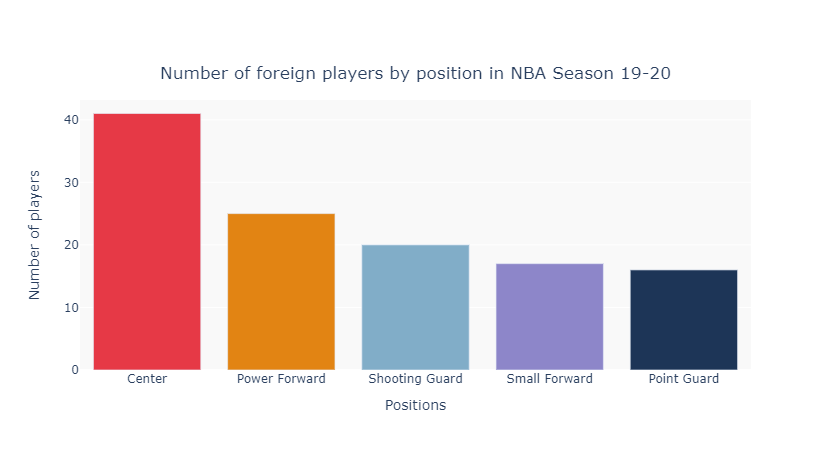

In [18]:

fig = px.bar(x=foreigns_by_position.index, y=foreigns_by_position, title='Number of foreign players by position in NBA Season 19-20')

fig.update_traces(marker_color=['#e63946',"#e28413","#81adc8","#8d86c9",'#1d3557'])
fig.update_traces(
    hovertemplate='<b>%{x}</b>' +  "<br>Number of players: %{y}<extra></extra>")
fig.update_layout(xaxis={'title':'Positions', 
                         'tickvals':[0,1,2,3,4],
                         'ticktext':['Center', 'Power Forward', 'Shooting Guard', 'Small Forward', 'Point Guard']},
                  yaxis={'title':'Number of players'},
                  title={
                        'y':0.85,
                        'x':0.5,
                        'xanchor': 'center',
                        'yanchor': 'top'},
                  plot_bgcolor="#F9F9F9")
plotly.offline.iplot(fig, filename='number_by_position')

The position with more foreign players is the Center, with 41 players. Then it is followed by the Power Forward with 25 players. The positions were more than half of the foreign players play are the ones with the highest average height, meaning that the majority of these players are tall people. 

### Foreign players in season 2019-20 by teams
Now that we know how many foreign players are in the NBA, where do they come from and which position do they play, let's analyze how these players are distributed through the NBA teams. 


In [19]:
foreigns_by_teams = nba_players_2020[nba_players_2020['foreign']==True].team_abbreviation.value_counts()

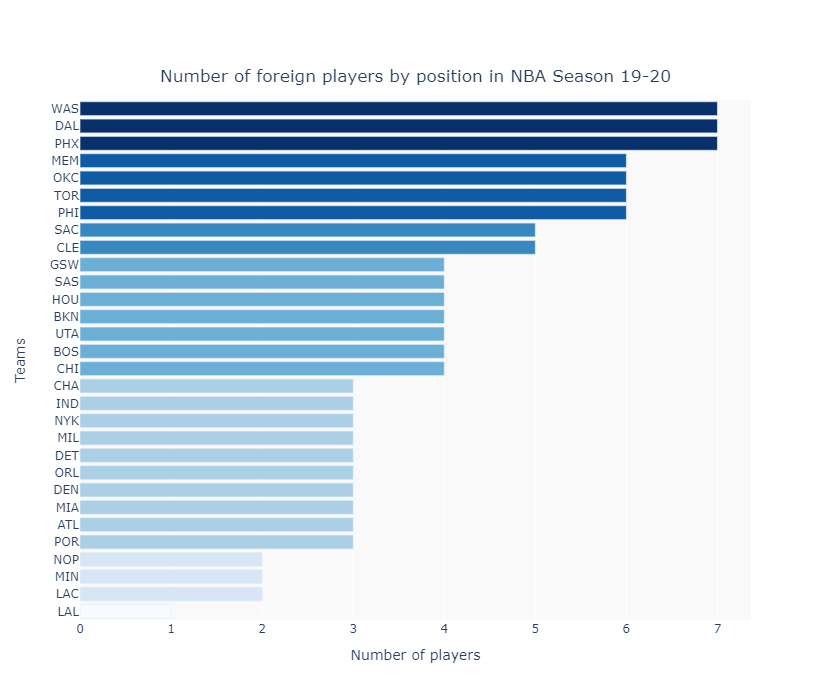

In [20]:
fig = px.bar(x=foreigns_by_teams, y=foreigns_by_teams.index, title='Number of foreign players by position in NBA Season 19-20',
             color=foreigns_by_teams, color_continuous_scale='Blues')
fig.update_yaxes(autorange="reversed")
fig.update_traces(
    hovertemplate="<br>Number of players: %{x}<extra></extra>")
fig.update_layout(xaxis={'title':'Number of players'},
                  yaxis={'title':'Teams'},
                  title={
                        'y':0.9,
                        'x':0.5,
                        'xanchor': 'center',
                        'yanchor': 'top'},
                  plot_bgcolor="#F9F9F9",
                  height=700)
fig.update(layout_coloraxis_showscale=False)
plotly.offline.iplot(fig, filename='number_by_team')

Some insights can be derived from the graph above:
* The teams with the highest number of foreign players are Phoenix Suns, Washington Wizards and Dallas Mavericks, with 7 players. 
* The team with the least number of foreign players is Los Angeles Lakers, with just one. 
* It is a curiosity that the Raptors that are located in Toronto, Canada isn't the team with the highest number of foreign players, they have 6.
* All the teams in NBA have foreign players, there isn't a team with just US players.

## Conclusions
Foreign players have become a crucial part of NBA, as right now in this season, they are almost a quarter of the total number of players. And it seems that this will only increase, as this has had a constant increment rate in previous years. 

These foreign players come from different parts of the world, but the majority comes from Europe, Canada and Australia. They tend to play more in positions where the height is a clear factor like Centers or Power Forwards. 

The great majority of teams in NBA have 3 or more foreign players, just four teams are under this level.